In [453]:
import numpy as np
import pandas as pd
import cv2
import os
from tqdm import tqdm
import matplotlib.pyplot as plt
from matplotlib.pyplot import imread
import glob
from moviepy.editor import ImageSequenceClip
from scipy.misc import imsave

In [934]:
from basic_lane_lines import weighted_img, find_lane3, crop_roi, gaussian_blur, canny

# Load Images from Video

In [3]:
def display_images(X, start_idx=0, end_idx=None,  step_val=1, 
                   columns = 5, use_gray=False, 
                   apply_fnc=None, figsize=(32,18)):
    """
    Display a set of images
    Parameters
    ----------
    X: numpy array of images
         Images to be displayed
    start_idx: int
         Start index for images
    end_idx: int
         End index for images
    step_val: int
        step value
    columns: int
         Number of columns of images
    use_gray: bool
         True for RGB images.  False for grayscale images.
    apply_fnc: function
         An function to apply to each image before displaying.
    figsize: tuple of int
         Display height and width of images.
    """
    if end_idx is None:
        end_idx = X.shape[0]
        
    if apply_fnc is None:
        apply_fnc = lambda image: image
        
    plt.figure(figsize=figsize)

    num_of_images = end_idx - start_idx
    rows = num_of_images / columns + 1
    
    cnt = 0
    for i in range(start_idx, end_idx, step_val):
        cnt += 1
        image = X[i]
        
        plt.subplot(rows, columns, cnt)
        
        if use_gray:
            plt.imshow(apply_fnc(image), cmap="gray")
        else:
            plt.imshow(apply_fnc(image)) 
            
    plt.tight_layout()
            
    plt.show()

In [4]:
def read_imgs(file_names):
    """
    Read list of images from disk.
    Parameters
    ----------
    file_names: list of str
         List of image file names.
    Returns
    -------
    numpy array of images:
         Images from disk.
    """
    img_arr = []
    
    for file_name in file_names:
        img = imread(file_name)
        img_arr.append(img)
        
    return np.stack(img_arr)

In [5]:
def pad_zeros(val, num_of_zeros=7):
    pad_str = '{:0>%d}' % num_of_zeros
    return pad_str.format(val)

In [6]:
def extract_video_imgs(video, output_dir):
    os.makedirs(output_dir, exist_ok=True)
    
    vidcap = cv2.VideoCapture(video)
    length = int(vidcap.get(cv2.CAP_PROP_FRAME_COUNT))
    
    success,image = vidcap.read()
    for i in tqdm(range(length)):
        if success:
            success, image = vidcap.read()
        
            if success:
                frame_file = "%s/frame_%s.jpg" % (output_dir, pad_zeros(i))
                cv2.imwrite(frame_file, image)     # save frame as JPEG file
        else:
            print("WARNING: frame #%d could not be read. Stopping.")
            break

In [7]:
data_dir = 'data'

In [8]:
video = 'project_video.mp4'
output_dir = '%s/project_video' % data_dir
extract_video_imgs(video, output_dir)

100%|██████████| 1260/1260 [01:24<00:00, 14.89it/s]

In [10]:
video_image_files = sorted(glob.glob('%s/*.jpg' % output_dir))
len(video_image_files)

1259

In [11]:
[video_image_files[i] for i in range(0, len(video_image_files), 126)]

['data/project_video/frame_0000000.jpg',
 'data/project_video/frame_0000126.jpg',
 'data/project_video/frame_0000252.jpg',
 'data/project_video/frame_0000378.jpg',
 'data/project_video/frame_0000504.jpg',
 'data/project_video/frame_0000630.jpg',
 'data/project_video/frame_0000756.jpg',
 'data/project_video/frame_0000882.jpg',
 'data/project_video/frame_0001008.jpg',
 'data/project_video/frame_0001134.jpg']

In [12]:
sample_video_imgs_np = read_imgs([video_image_files[i] for i in range(0, len(video_image_files), 126)])

In [13]:
sample_video_imgs_np.shape

(10, 720, 1280, 3)

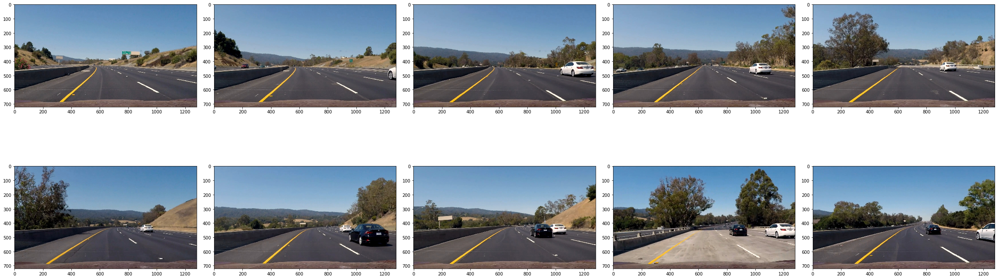

In [15]:
display_images(sample_video_imgs_np, start_idx=0, columns=5, figsize=(32,16))

# Calibrate Camera

In [16]:
camera_cal_dir = 'camera_cal'

In [17]:
def load_camera_cal_images(camera_cal_dir):
    img_files = glob.glob('%s/*.jpg' % camera_cal_dir)
    return [imread(img_file) for img_file in img_files], img_files

In [18]:
camera_cal_img_arr, camera_cal_img_files = load_camera_cal_images(camera_cal_dir)

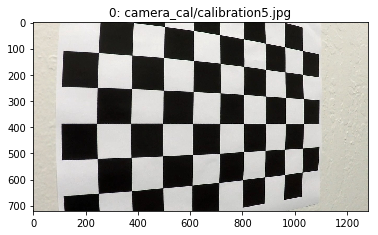

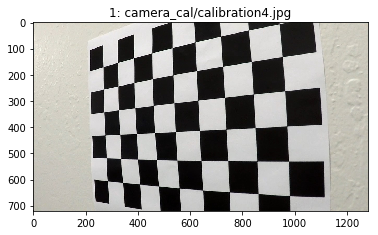

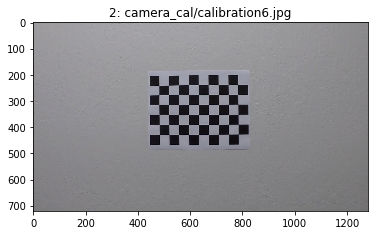

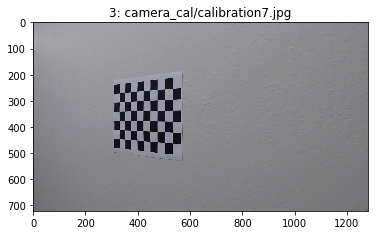

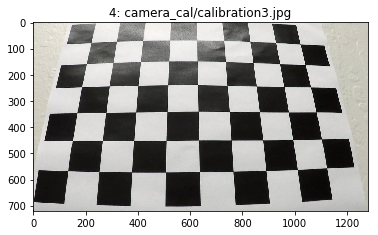

...

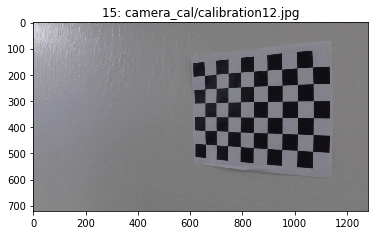

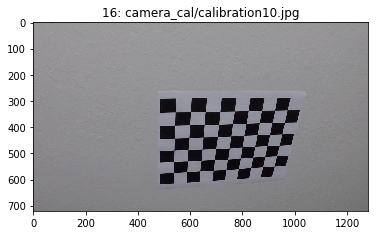

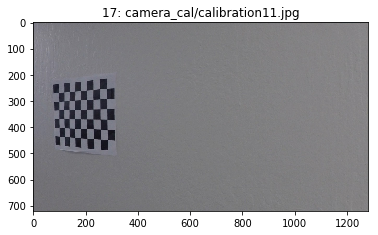

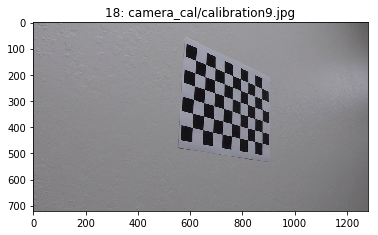

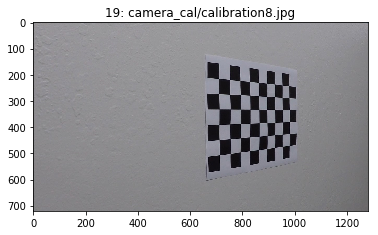

In [19]:
for i, camera_cal_img in enumerate(camera_cal_img_arr):
    plt.title('%d: %s' % (i, camera_cal_img_files[i]))
    plt.imshow(camera_cal_img)
    plt.show()

In [20]:
test_img = camera_cal_img_arr[6]
camera_cal_img_arr = [camera_cal_img_arr[i] for i in range(len(camera_cal_img_arr)) if i != 6]
camera_cal_img_files = [camera_cal_img_files [i] for i in range(len(camera_cal_img_files)) if i != 6]

In [21]:
objpoints = []
imgpoints = []

# termination criteria
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)
    
for img in tqdm(camera_cal_img_arr):
    x_cnt = 9
    y_cnt = 6

    objp = np.zeros((y_cnt*x_cnt,3), np.float32)
    objp[:,:2] = np.mgrid[0:x_cnt,0:y_cnt].T.reshape(-1,2)

    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    ret, corners = cv2.findChessboardCorners(gray, (y_cnt, x_cnt), None)

    if ret:
        objpoints.append(objp)
        cv2.cornerSubPix(gray,corners, (11,11), (-1,-1), criteria)
        imgpoints.append(corners)   
        
        """
        _img = img.copy()
        _img = cv2.drawChessboardCorners(_img, (y_cnt, x_cnt), corners, True)
        
        print(i)
        plt.imshow(img)
        plt.show()
        plt.imshow(_img)
        plt.show()
        """
        
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

"""
print("Ret:",ret)
print("Mtx:", mtx.shape, "\n", mtx)
print("Dist:",dist.shape, "\n", dist)
print("rvecs:",rvecs[0].shape, "\n", rvecs)
print("tvecs:",tvecs[0].shape, "\n", tvecs)
"""

100%|██████████| 19/19 [00:05<00:00,  2.77it/s]


'\nprint("Ret:",ret)\nprint("Mtx:", mtx.shape, "\n", mtx)\nprint("Dist:",dist.shape, "\n", dist)\nprint("rvecs:",rvecs[0].shape, "\n", rvecs)\nprint("tvecs:",tvecs[0].shape, "\n", tvecs)\n'

In [22]:
def cal_undistort(img, objpoints, imgpoints):
    # Use cv2.calibrateCamera() and cv2.undistort()
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, 
                                                        gray.shape[::-1], 
                                                        None, None)
    
    undist = cv2.undistort(img, mtx, dist, None, mtx)

    return undist

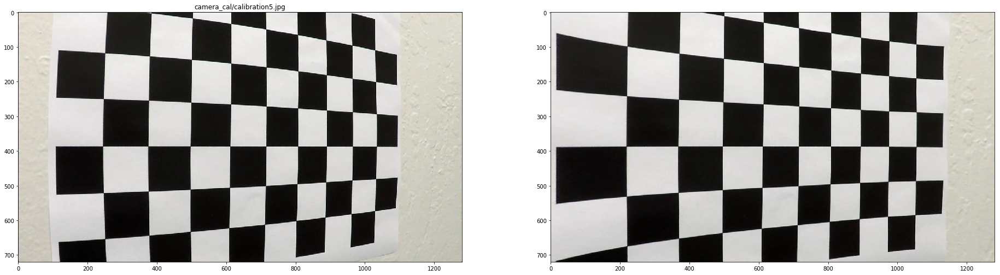

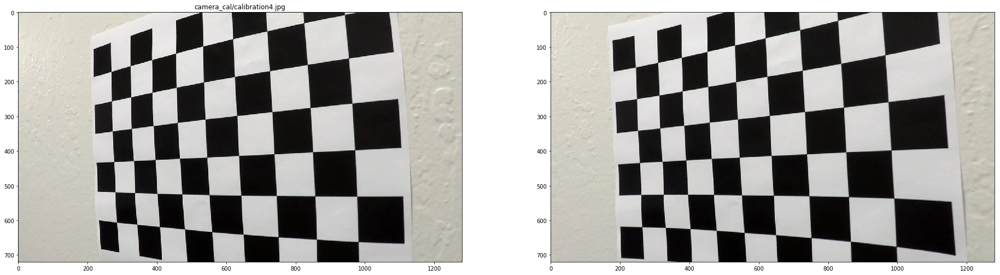

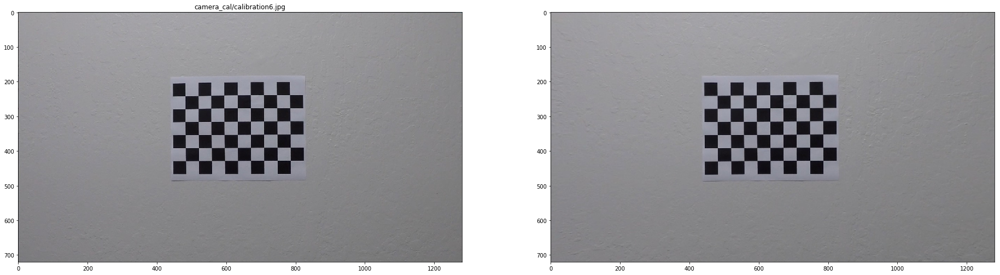

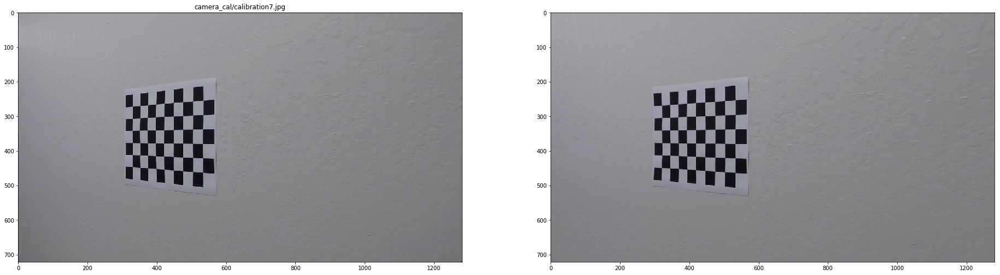

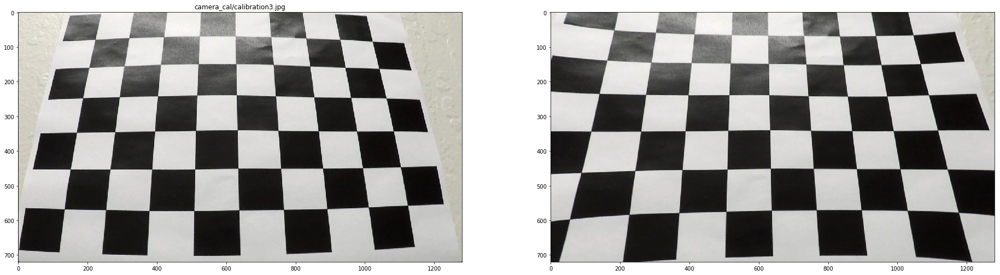

...

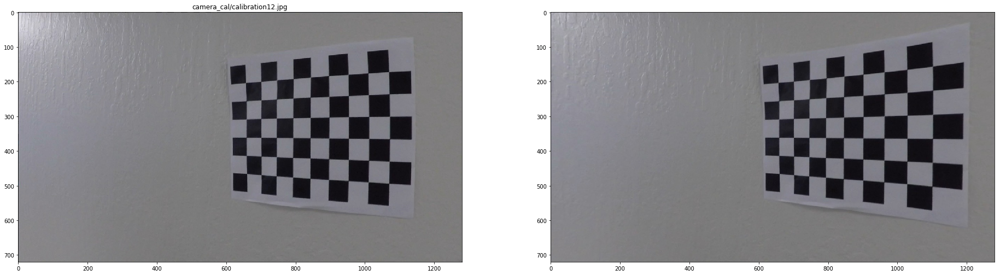

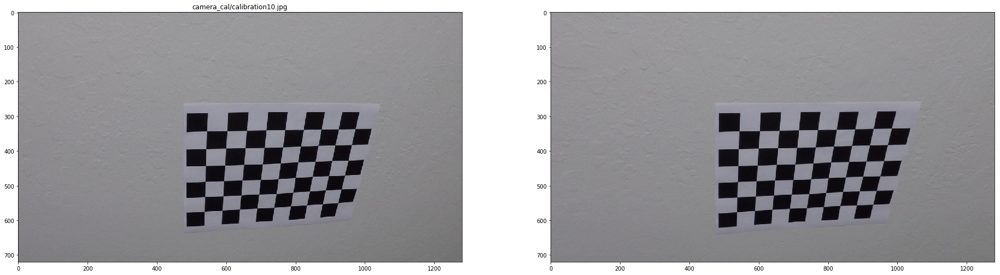

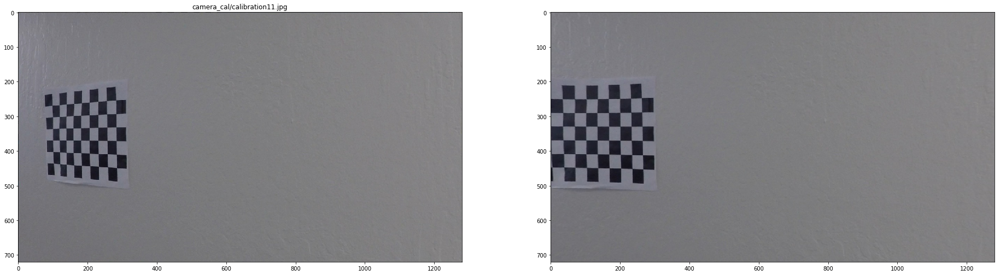

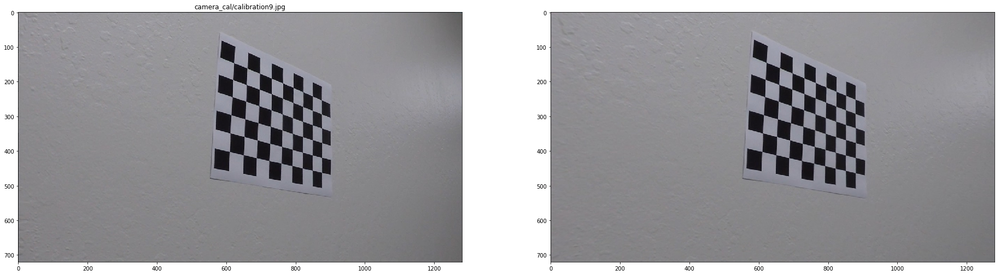

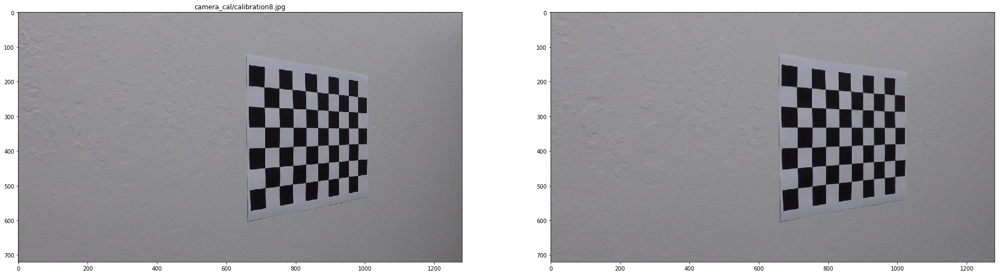

In [23]:
for i, img in enumerate(camera_cal_img_arr):
    undistorted_img = cal_undistort(img, objpoints, imgpoints)
    
    plt.figure(figsize=(32,32))

    plt.subplot(1,2,1)
    plt.title(camera_cal_img_files[i])
    plt.imshow(img)
    plt.subplot(1,2,2)
    plt.imshow(undistorted_img)
    plt.show()

In [24]:
type(objpoints[0])

numpy.ndarray

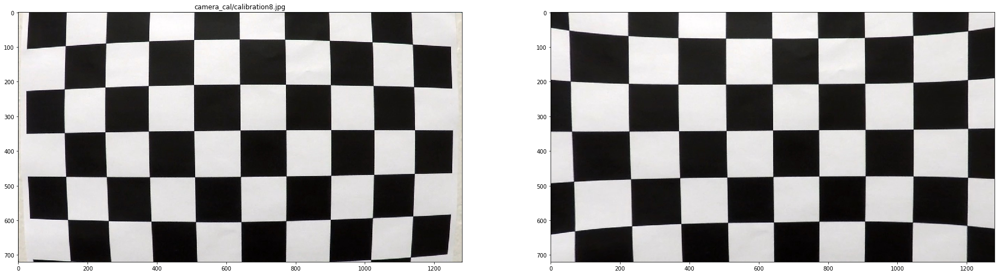

In [25]:
undistorted_img = cal_undistort(test_img, objpoints, imgpoints)
    
plt.figure(figsize=(32,32))

plt.subplot(1,2,1)
plt.title(camera_cal_img_files[i])
plt.imshow(test_img)
plt.subplot(1,2,2)
plt.imshow(undistorted_img)
plt.show()

# Pipeline

In [26]:
def load_test_images(test_img_dir):
    img_files = glob.glob('%s/*.jpg' % test_img_dir)
    return [imread(img_file) for img_file in img_files], img_files

In [27]:
test_image_arr, test_img_files = load_test_images('test_images')

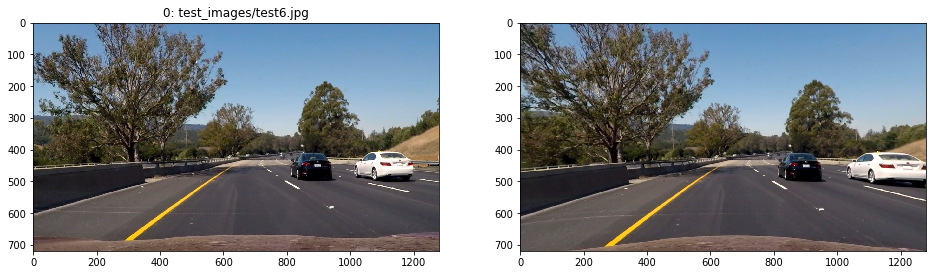

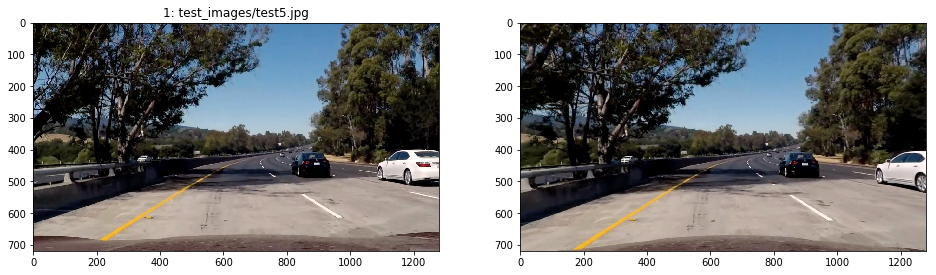

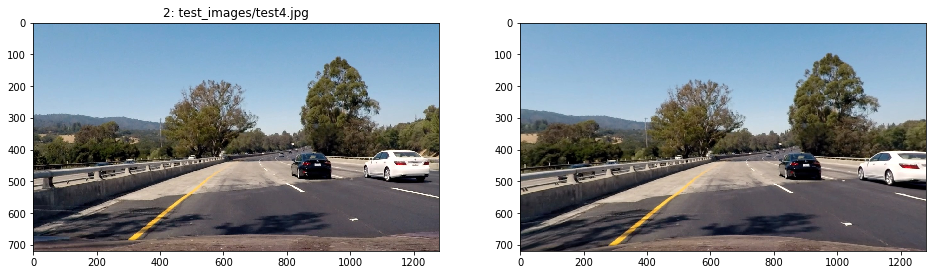

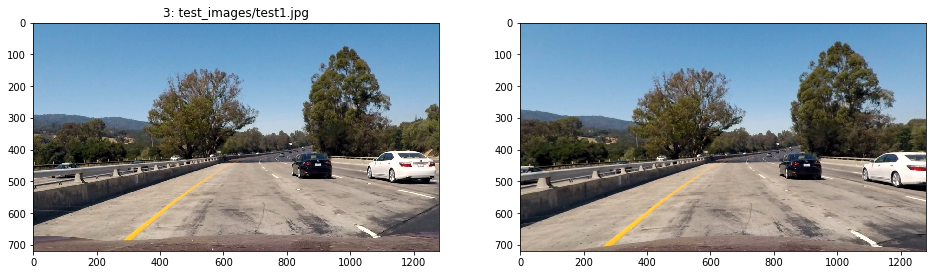

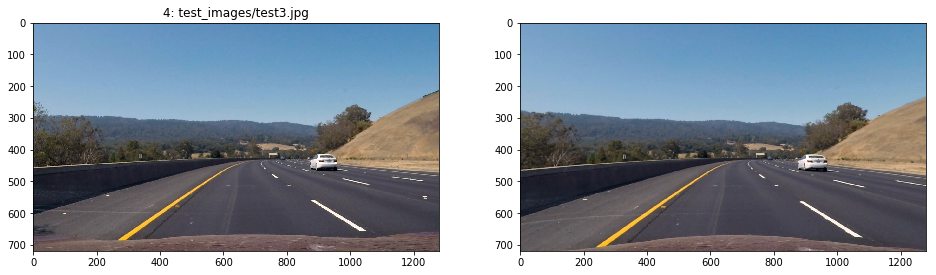

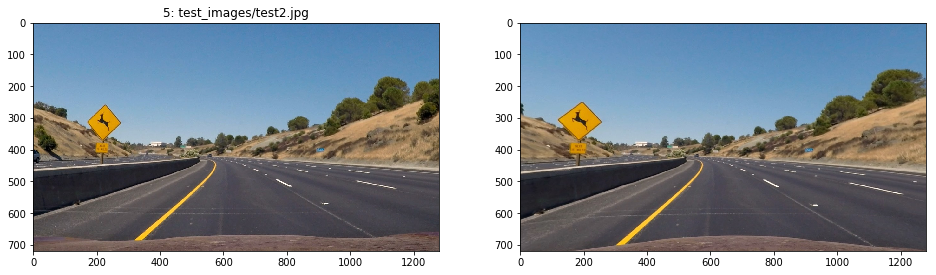

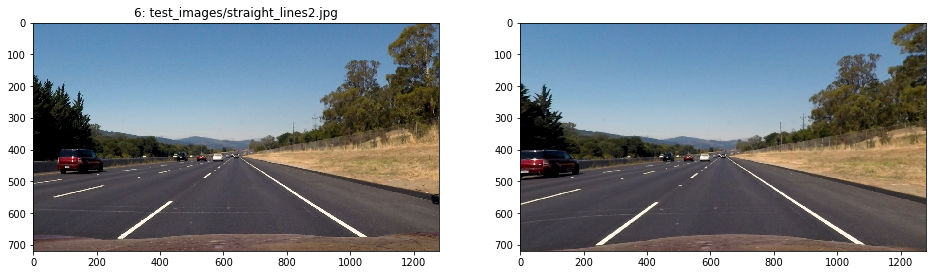

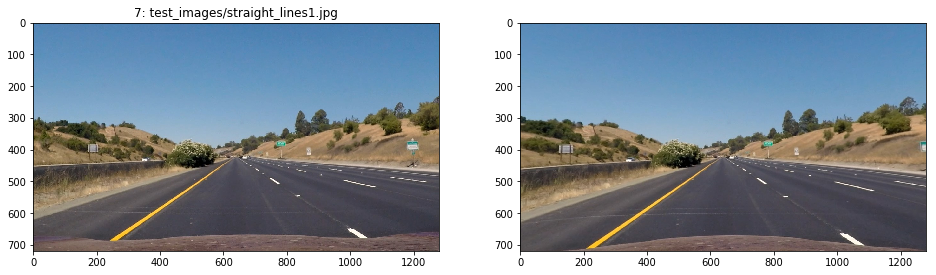

In [28]:
for i,img in enumerate(test_image_arr):
    undistorted_img = cal_undistort(img, objpoints, imgpoints)
    
    plt.figure(figsize=(16,16))
    
    plt.subplot(1,2,1)
    plt.title("%d: %s" % (i, test_img_files[i]))
    plt.imshow(img)
    plt.subplot(1,2,2)
    plt.imshow(undistorted_img)
    plt.show()

## Has the distortion correction been correcctly applied to each image?

In [29]:
test_road_img = test_image_arr[2]
undistorted_road_img = cal_undistort(test_road_img, objpoints, imgpoints)

In [30]:
gray_test_road_img = cv2.cvtColor(test_road_img, cv2.COLOR_RGB2GRAY)
gray_undistorted_road_img = cv2.cvtColor(undistorted_road_img, cv2.COLOR_RGB2GRAY)

height, width = gray_undistorted_road_img.shape
overlayed_test_img = np.zeros((height, width, 3))

overlayed_test_img[:,:,0] = gray_test_road_img
overlayed_test_img[:,:,1] = gray_undistorted_road_img

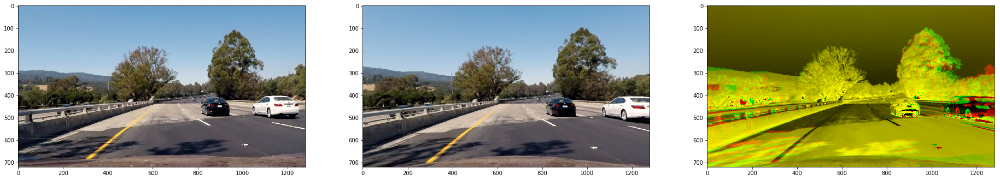

In [31]:
undistorted_road_img = cal_undistort(test_road_img, objpoints, imgpoints)
    
plt.figure(figsize=(32,32))
    
plt.subplot(1,3,1)
plt.imshow(test_road_img)
plt.subplot(1,3,2)
plt.imshow(undistorted_road_img)
plt.subplot(1,3,3)
plt.imshow(overlayed_test_img)
plt.show()

## 2. Has a binary image been created using color transforms, gradients or other methods?

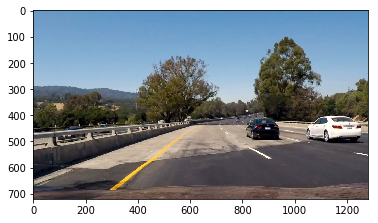

In [687]:
#sample_video_img = sample_video_imgs_np[0]
#sample_video_img = imread('data/project_video/frame_0000546.jpg')
sample_video_img = imread('data/project_video/frame_0000991.jpg')

plt.imshow(sample_video_img)
plt.show()

In [688]:
undistorted_sample_video_img = cal_undistort(sample_video_img, objpoints, imgpoints)

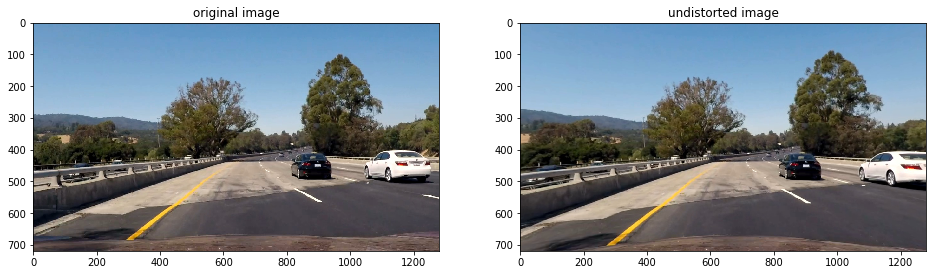

In [689]:
plt.figure(figsize=(16,16))
plt.subplot(1,2,1)
plt.title('original image')
plt.imshow(sample_video_img)
plt.subplot(1,2,2)
plt.title('undistorted image')
plt.imshow(undistorted_sample_video_img)
plt.show()

In [690]:
lane_line_sample_video_img = weighted_img(find_lane3(undistorted_sample_video_img), undistorted_sample_video_img)

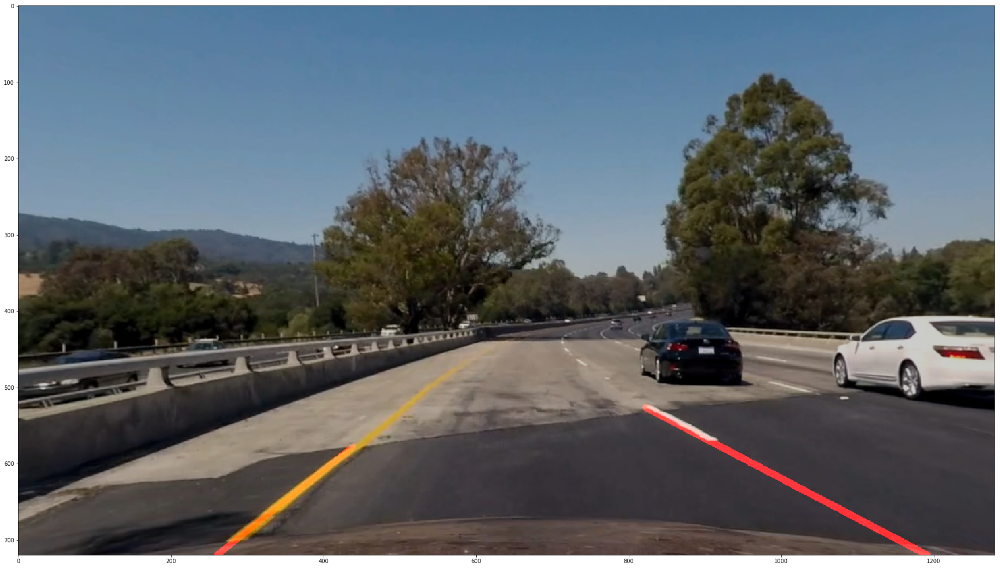

In [691]:
plt.figure(figsize=(32,32))
plt.imshow(lane_line_sample_video_img)
plt.show()

## 3. Has a perspective transform been applied to rectify the image?

In [692]:
def warp(img, src, dst):
    M = cv2.getPerspectiveTransform(src, dst)
        
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    
    Minv = cv2.getPerspectiveTransform(dst, src)
    
    return warped, Minv

In [693]:
img_size = (lane_line_sample_video_img.shape[1], lane_line_sample_video_img.shape[0])

src = np.float32(
     [[(img_size[0] / 2) - 60, img_size[1] / 2 + 120],
     [((img_size[0] / 6) + 50), img_size[1]],
     [(img_size[0] * 5 / 6) + 75, img_size[1]],
     [(img_size[0] / 2 + 115), img_size[1] / 2 + 120]])
dst = np.float32(
    [[(img_size[0] / 4), 0],
    [(img_size[0] / 4), img_size[1]],
    [(img_size[0] * 3 / 4), img_size[1]],
    [(img_size[0] * 3 / 4), 0]])    

In [694]:
warped_lane_line_sample_video_img, Minv = warp(lane_line_sample_video_img, src, dst)

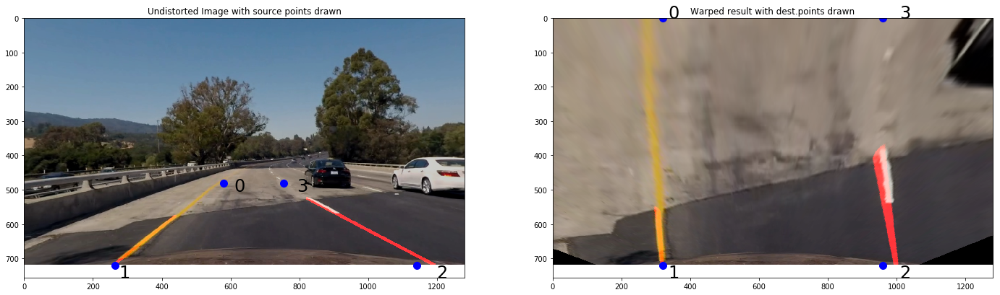

In [695]:
plt.figure(figsize=(24,32))

plt.subplot(1,2,1)
plt.title('Undistorted Image with source points drawn')
plt.imshow(lane_line_sample_video_img)
for i in range(src.shape[0]):
    x,y = src[i]
    plt.plot(x,y, 'bo', markersize=10)
    plt.text(x * (1.05), y * (1.05) , i, fontsize=24)
    
plt.subplot(1,2,2)
plt.title('Warped result with dest.points drawn')
plt.imshow(warped_lane_line_sample_video_img)
for i in range(dst.shape[0]):
    x,y = dst[i]
    plt.plot(x,y, 'bo', markersize=10)
    plt.text(x * (1.05), y * (1.05) , i, fontsize=24)

plt.show()

## 4. Have lane line pixels been identified in the rectified image and fit with a polynomial?

In [696]:
def abs_sobel_thresh(img, orient='x', thresh_min=0, thresh_max=255):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1

    # Return the result
    return binary_output

In [697]:
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1

    # Return the binary image
    return binary_output

In [698]:
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

    # Return the binary image
    return binary_output

In [699]:
def hls_select(img, thresh=(0, 255)):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    binary_output = np.zeros_like(s_channel)
    binary_output[(s_channel > thresh[0]) & (s_channel <= thresh[1])] = 1
    return binary_output

In [700]:
warped_sample_video_img, Minv = warp(lane_line_sample_video_img, src, dst)

In [701]:
abs_sobel_thresh_x_sample_video_img = abs_sobel_thresh(warped_sample_video_img, 
                                                     orient='x', thresh_min=20, thresh_max=100)
abs_sobel_thresh_y_sample_video_img = abs_sobel_thresh(warped_sample_video_img, 
                                                     orient='y', thresh_min=20, thresh_max=100)
mag_thresh_sample_video_img = mag_thresh(warped_sample_video_img, mag_thresh=(30, 100))
dir_threshold_sample_video_img = dir_threshold(warped_sample_video_img,
                                               sobel_kernel=15, thresh=(0.7, 1.3))
hls_binary_sample_video_img = hls_select(warped_sample_video_img, thresh=(90, 255))

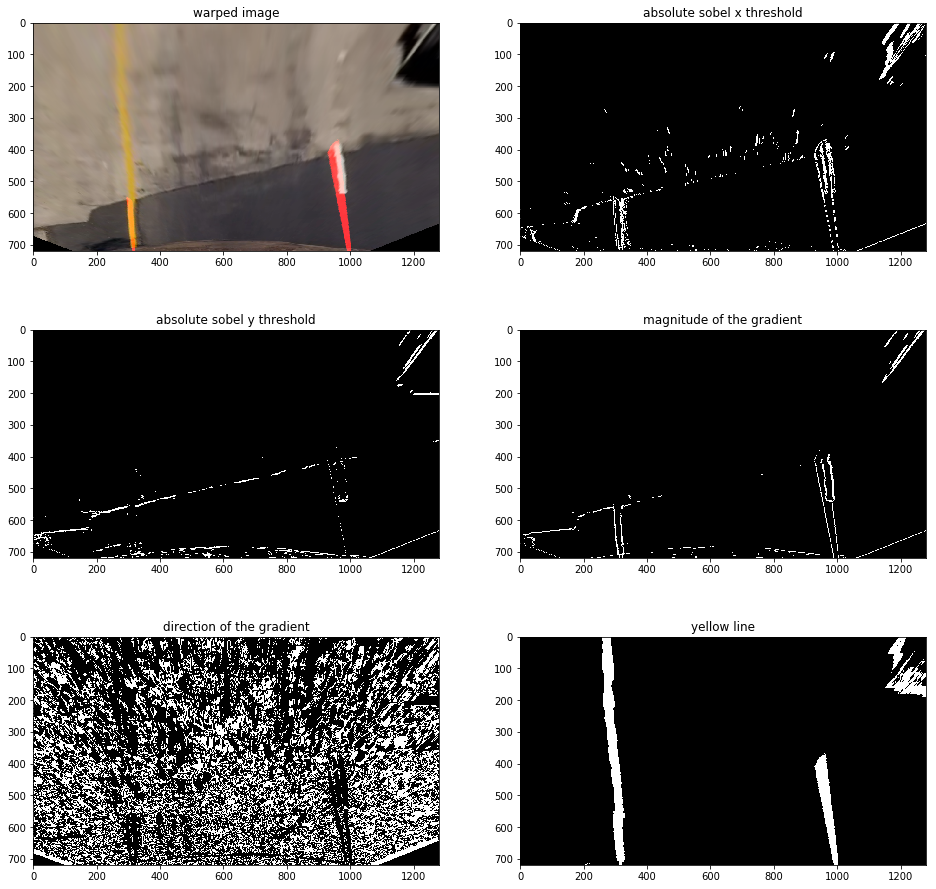

In [702]:
i = 1
cols = 2
rows = 3

plt.figure(figsize=(16,16))

plt.subplot(rows,cols,i)
plt.title('warped image')
plt.imshow(warped_sample_video_img, cmap='gray')

i += 1
plt.subplot(rows,cols,i)
plt.title('absolute sobel x threshold')
plt.imshow(abs_sobel_thresh_x_sample_video_img, cmap='gray')

i += 1
plt.subplot(rows,cols,i)
plt.title('absolute sobel y threshold')
plt.imshow(abs_sobel_thresh_y_sample_video_img, cmap='gray')

i += 1
plt.subplot(rows,cols,i)
plt.title('magnitude of the gradient')
plt.imshow(mag_thresh_sample_video_img, cmap='gray')

i += 1
plt.subplot(rows,cols,i)
plt.title('direction of the gradient')
plt.imshow(dir_threshold_sample_video_img, cmap='gray')

i += 1
plt.subplot(rows,cols,i)
plt.title('yellow line')
plt.imshow(hls_binary_sample_video_img, cmap='gray')
plt.show()

In [703]:
def combine_thresholds(abs_sobel_x_thresh_img, abs_sobel_y_thresh_img, 
                      mag_thresh_img, dir_threshold_img,
                      hls_binary_img):    
    combined_thresholds_img = np.logical_or(abs_sobel_x_thresh_img, abs_sobel_y_thresh_img)
    combined_thresholds_img = np.logical_or(combined_thresholds_img, mag_thresh_img)
    combined_thresholds_img = np.logical_or(combined_thresholds_img, hls_binary_img)
    
    return 255*combined_thresholds_img.astype(np.uint8)

In [704]:
combine_thresholds_sample_video_img = combine_thresholds(abs_sobel_thresh_x_sample_video_img,
                                                        abs_sobel_thresh_y_sample_video_img,
                                                        mag_thresh_sample_video_img, 
                                                        dir_threshold_sample_video_img,
                                                        hls_binary_sample_video_img)

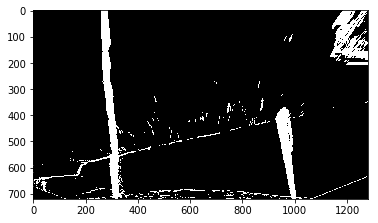

In [705]:
plt.imshow(combine_thresholds_sample_video_img, cmap='gray')
plt.show()

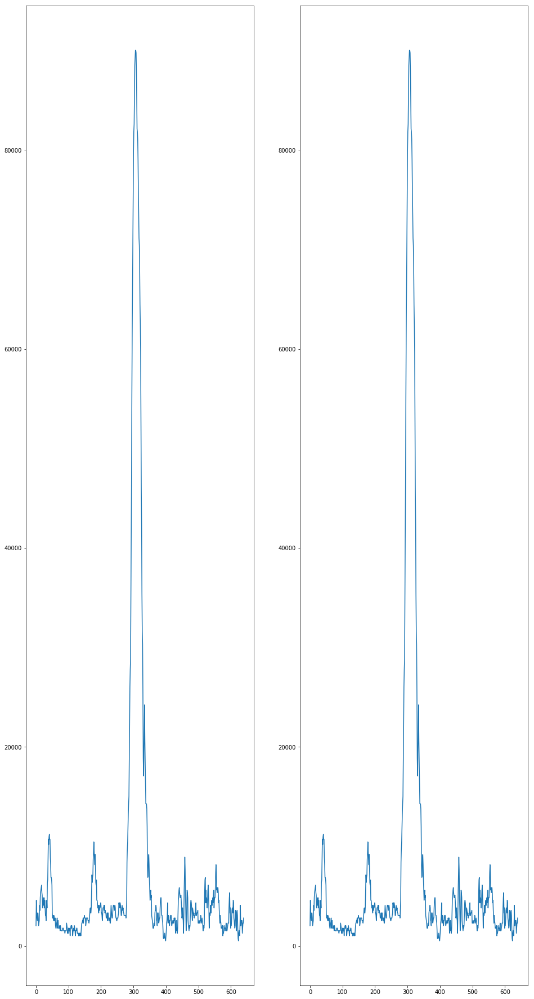

In [706]:
x_midpoint = combine_thresholds_sample_video_img.shape[1] // 2
left_img = combine_thresholds_sample_video_img[:, :x_midpoint]
left_histogram = np.sum(left_img[left_img.shape[0]//2:,:], axis=0)

right_img = combine_thresholds_sample_video_img[:, x_midpoint:]
right_histogram = np.sum(right_img[right_img.shape[0]//2:,:], axis=0)

plt.figure(figsize=(16,32))
plt.subplot(1,2,1)
plt.plot(left_histogram)
plt.subplot(1,2,2)
plt.plot(left_histogram)
plt.show()

In [707]:
binary_warped = np.expand_dims(combine_thresholds_sample_video_img, axis=2)

In [708]:
binary_warped.shape

(720, 1280, 1)

In [709]:
def fit_initial_lanes(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)

    # Create an output image to draw on and  visualize the result
    out_img = (np.dstack((binary_warped, binary_warped, binary_warped))*255).astype(np.uint8)

    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9

    # Set height of windows
    window_height = np.int(binary_warped.shape[0]//nwindows)
    
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])

    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Set the width of the windows +/- margin
    margin = 100

    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
    
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high), (0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high), (0,255,0), 2) 
    
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
    
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
    
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
    
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    return left_fit, right_fit, left_lane_inds, right_lane_inds, nonzeroy, nonzerox, out_img

In [953]:
def get_basic_lane_lines(img):
    undistorted_img = cal_undistort(img, objpoints, imgpoints)
    undistorted_lane_lines = find_lane3(undistorted_img)
    undistorted_lane_lines[:,:,1] = undistorted_lane_lines[:,:,0]
    undistorted_lane_lines[:,:,2] = undistorted_lane_lines[:,:,0]
    
    return undistorted_lane_lines

In [974]:
def apply_img_pipeline(img, objpoints, imgpoints):
    img_size = (img.shape[1], img.shape[0])

    src = np.float32(
         [[(img_size[0] / 2) - 60, img_size[1] / 2 + 120],
         [((img_size[0] / 6) + 50), img_size[1]],
         [(img_size[0] * 5 / 6) + 75, img_size[1]],
         [(img_size[0] / 2 + 115), img_size[1] / 2 + 120]])
    dst = np.float32(
        [[(img_size[0] / 4), 0],
        [(img_size[0] / 4), img_size[1]],
        [(img_size[0] * 3 / 4), img_size[1]],
        [(img_size[0] * 3 / 4), 0]])      
    
    undistorted_img = cal_undistort(img, objpoints, imgpoints)   

    """
    plt.subplot(1,3,1)
    plt.imshow(undistorted_img)
    """
    
    warped_img, Minv = warp(undistorted_img, src, dst)

    """
    plt.subplot(1,3,2)
    plt.imshow(warped_img)
    """

    abs_sobel_thresh_x_img = abs_sobel_thresh(warped_img, orient='x', thresh_min=20, thresh_max=100)
    abs_sobel_thresh_y_img = abs_sobel_thresh(warped_img, orient='y', thresh_min=20, thresh_max=100)
    mag_thresh_img = mag_thresh(warped_img, mag_thresh=(30, 100))
    dir_threshold_img = dir_threshold(warped_img, sobel_kernel=15, thresh=(0.7, 1.3))
    hls_binary_img = hls_select(warped_img, thresh=(90, 255))    
    
    combine_thresholds_img = combine_thresholds(abs_sobel_thresh_x_img, abs_sobel_thresh_y_img,
                                                mag_thresh_img, dir_threshold_img,
                                                hls_binary_img)  
    
    """
    plt.subplot(1,3,3)
    plt.imshow(combine_thresholds_img)
    plt.show()
    """

    return combine_thresholds_img, Minv

In [714]:
sample_video_imgs_np = read_imgs(video_image_files[990:1000])
sample_video_imgs_arr = [sample_video_imgs_np[i] for i in range(sample_video_imgs_np.shape[0])]                                 

In [715]:
sample_video_imgs_arr[0].shape

(720, 1280, 3)

In [716]:
binary_warped_img_arr = []
Minv_arr = []

for sample_video_img in tqdm(sample_video_imgs_arr):
    binary_warped_img, Minv = apply_img_pipeline(sample_video_img, objpoints, imgpoints) 
    
    binary_warped_img_arr.append(binary_warped_img)
    Minv_arr.append(Minv)


100%|██████████| 10/10 [00:22<00:00,  2.85s/it]


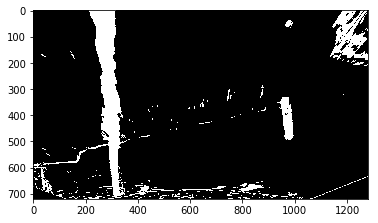

In [717]:
plt.imshow(binary_warped_img_arr[0], cmap='gray')
plt.show()

In [718]:
left_fit, right_fit, left_lane_inds, right_lane_inds, nonzeroy, nonzerox, out_img = fit_initial_lanes(binary_warped_img_arr[0])

In [719]:
def plot_lanes(binary_warped, left_fit, right_fit, left_lane_inds, right_lane_inds, nonzeroy, nonzerox, out_img):
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    plt.imshow(out_img)
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    
    plt.show()

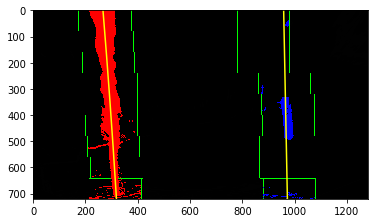

In [720]:
plot_lanes(binary_warped_img_arr[0], left_fit, right_fit, left_lane_inds, right_lane_inds, nonzeroy, nonzerox, out_img)

In [862]:
def fit_lanes(binary_warped, left_fit, right_fit, margin = 100):
    # Assume you now have a new warped binary image 
    # from the next frame of video (also called "binary_warped")
    # It's now much easier to find line pixels!
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    # Create an output image to draw on and  visualize the result
    out_img = (np.dstack((binary_warped, binary_warped, binary_warped))*255).astype(np.uint8)    

    
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
    left_fit[1]*nonzeroy + left_fit[2] + margin))) 

    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
    right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    
    print("###fit_lane - leftx", len(leftx))
    left_min_y = np.min(lefty)
    left_max_y = np.max(lefty)
    print("###fit_lane - left_min_y, left_max_y", left_min_y, left_max_y)  
    
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    print("###fit_lane - rightx", len(rightx))
    right_min_y = np.min(righty)
    right_max_y = np.max(righty)
    print("###fit_lane - right_min_y, right_max_y", right_min_y, right_max_y) 
    
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    return left_fit, right_fit, left_lane_inds, right_lane_inds, nonzeroy, nonzerox, out_img

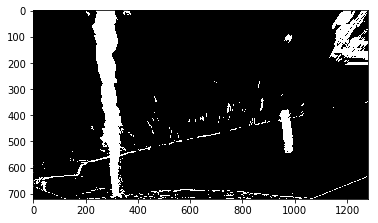

In [725]:
plt.imshow(binary_warped_img_arr[1], cmap='gray')
plt.show()

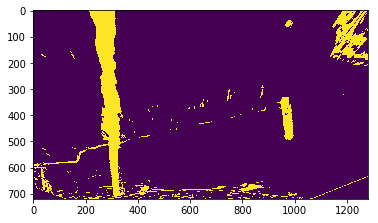

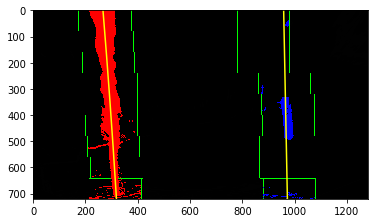

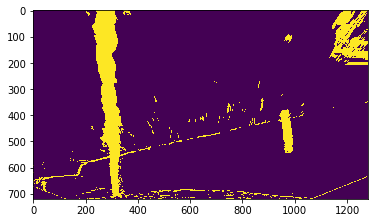

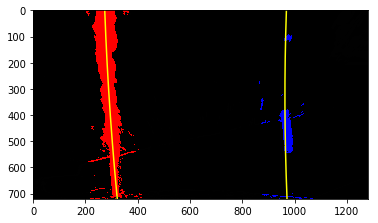

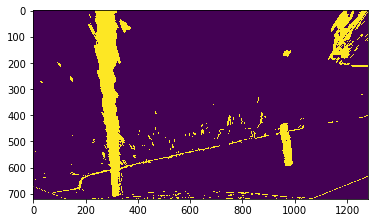

...

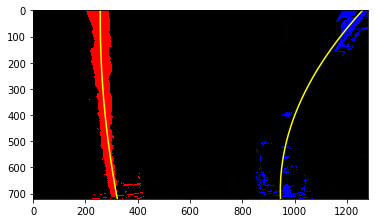

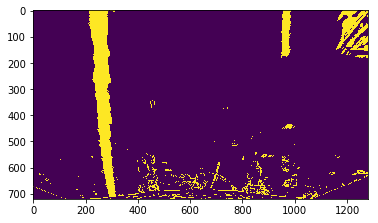

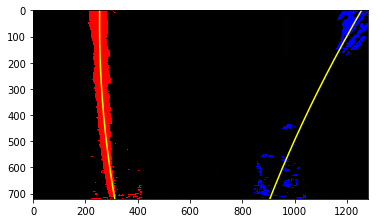

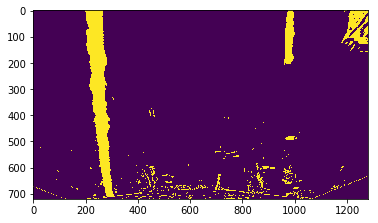

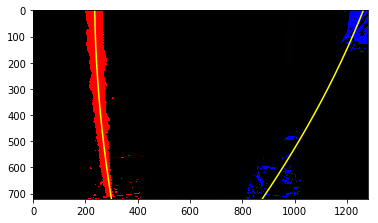

In [723]:
for i in range(0,len(binary_warped_img_arr)):
#for i in range(1):
    if i == 0:
        left_fit, right_fit, left_lane_inds, right_lane_inds, nonzeroy, nonzerox, out_img = \
            fit_initial_lanes(binary_warped_img_arr[i])
    else:
        bottom_left_x = left_fit[0]*binary_warped_img_arr[i].shape[0]**2 \
                                + left_fit[1]*binary_warped_img_arr[i].shape[0] + left_fit[2]
        
        bottom_right_x =  right_fit[0]*binary_warped_img_arr[i].shape[0]**2 \
                                + right_fit[1]*binary_warped_img_arr[i].shape[0] + right_fit[2]
            
        top_left_x = left_fit[2]
        top_right_x = right_fit[2]
            
        left_fit, right_fit, left_lane_inds, right_lane_inds, nonzeroy, nonzerox, out_img = \
            fit_lanes(binary_warped_img_arr[i], left_fit, right_fit,
                      bottom_left_x, bottom_right_x)
        
    plt.imshow(binary_warped_img_arr[i])
    plt.show()
    plot_lanes(binary_warped_img_arr[0], left_fit, right_fit, left_lane_inds, right_lane_inds, nonzeroy, nonzerox, out_img)

# Sliding Window

In [628]:
# window settings
window_width = 50 
window_height = 80 # Break image into 9 vertical layers since image height is 720
margin = 100 # How much to slide left and right for searching

In [629]:
def window_mask(width, height, img_ref, center,level):
    output = np.zeros_like(img_ref)
    output[int(img_ref.shape[0]-(level+1)*height):int(img_ref.shape[0]-level*height),
           max(0,int(center-width/2)):min(int(center+width/2),img_ref.shape[1])] = 1
    return output

In [630]:
def find_window_centroids(image, window_width = 50, window_height = 80, margin = 100):
    
    window_centroids = [] # Store the (left,right) window centroid positions per level
    window = np.ones(window_width) # Create our window template that we will use for convolutions
    
    # First find the two starting positions for the left and right lane by using np.sum to get the vertical image slice
    # and then np.convolve the vertical image slice with the window template 
    
    # Sum quarter bottom of image to get slice, could use a different ratio
    l_sum = np.sum(image[int(3*image.shape[0]/4):,:int(image.shape[1]/2)], axis=0)
    l_center = np.argmax(np.convolve(window,l_sum))-window_width/2
    r_sum = np.sum(image[int(3*image.shape[0]/4):,int(image.shape[1]/2):], axis=0)
    r_center = np.argmax(np.convolve(window,r_sum))-window_width/2+int(image.shape[1]/2)
    
    # Add what we found for the first layer
    window_centroids.append((l_center,r_center))
    
    # Go through each layer looking for max pixel locations
    for level in range(1,(int)(image.shape[0]/window_height)):
        # convolve the window into the vertical slice of the image
        image_layer = np.sum(image[int(image.shape[0]-(level+1)*window_height):int(image.shape[0]-level*window_height),:], axis=0)
        conv_signal = np.convolve(window, image_layer)
        # Find the best left centroid by using past left center as a reference
        # Use window_width/2 as offset because convolution signal reference is at right side of window, not center of window
        offset = window_width/2
        l_min_index = int(max(l_center+offset-margin,0))
        l_max_index = int(min(l_center+offset+margin,image.shape[1]))
        l_center = np.argmax(conv_signal[l_min_index:l_max_index])+l_min_index-offset
        # Find the best right centroid by using past right center as a reference
        r_min_index = int(max(r_center+offset-margin,0))
        r_max_index = int(min(r_center+offset+margin,image.shape[1]))
        r_center = np.argmax(conv_signal[r_min_index:r_max_index])+r_min_index-offset
        # Add what we found for that layer
        window_centroids.append((l_center,r_center))

    return window_centroids

In [631]:
warped = binary_warped_img_arr[0]

In [632]:
warped.min(), warped.max()

(0, 255)

In [633]:
window_centroids = find_window_centroids(warped, window_width = 50, window_height = 80, margin = 100)

In [634]:
window_centroids

[(282.0, 956.0),
 (280.0, 957.0),
 (284.0, 953.0),
 (269.0, 948.0),
 (265.0, 848.0),
 (256.0, 816.0),
 (250.0, 766.0),
 (245.0, 796.0),
 (231.0, 895.0)]

In [635]:
def convert_window_centroids_to_polyfit(binary_warped, window_centroids):
    leftx_arr = []
    rightx_arr = []
    
    for i in range(len(window_centroids)):
        leftx_arr.append(window_centroids[i][0])
        rightx_arr.append(window_centroids[i][1])
        
    y_spacing = binary_warped.shape[0]/(len(window_centroids)-1)
    y_arr = [y_spacing * i for i in range(len(window_centroids))]
    
    # Fit a second order polynomial to each
    left_fit = np.polyfit(y_arr, leftx_arr, 2)
    right_fit = np.polyfit(y_arr, rightx_arr, 2)
                                          
    return left_fit, right_fit

In [975]:
def get_window_centroid_fit(warped, window_width = 50, window_height = 80, margin = 100):
    window_centroids = find_window_centroids(warped, window_width = 50, window_height = 80, margin = 100)
    
    """
    plt.imshow(get_output_from_centroids(warped, window_centroids))
    plt.show()
    """
    
    return convert_window_centroids_to_polyfit(warped, window_centroids)

In [637]:
left_fit, right_fit = convert_window_centroids_to_polyfit(warped, window_centroids)

In [638]:
def get_output_from_centroids(warped, window_centroids):
    # If we found any window centers
    if len(window_centroids) > 0:

        # Points used to draw all the left and right windows
        l_points = np.zeros_like(warped)
        r_points = np.zeros_like(warped)

        # Go through each level and draw the windows 
        for level in range(0,len(window_centroids)):
            # Window_mask is a function to draw window areas
            l_mask = window_mask(window_width,window_height,warped,window_centroids[level][0],level)
            r_mask = window_mask(window_width,window_height,warped,window_centroids[level][1],level)
            # Add graphic points from window mask here to total pixels found 
            l_points[(l_points == 255) | ((l_mask == 1) ) ] = 255
            r_points[(r_points == 255) | ((r_mask == 1) ) ] = 255

        # Draw the results
        template = np.array(r_points+l_points,np.uint8) # add both left and right window pixels together
        zero_channel = np.zeros_like(template) # create a zero color channel
        template = np.array(cv2.merge((zero_channel,template,zero_channel)),np.uint8) # make window pixels green
        warpage= (np.dstack((warped, warped, warped))*255).astype(np.uint8) # making the original road pixels 3 color channels
        output = cv2.addWeighted(warpage, 1, template, 0.5, 0.0) # overlay the orignal road image with window results
 
    # If no window centers found, just display orginal road image
    else:
        output = np.array(cv2.merge((warped,warped,warped)),np.uint8)
        
    return output

In [639]:
output = get_output_from_centroids(warped, window_centroids)

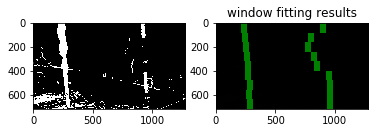

In [640]:
# Display the final results
plt.subplot(1,2,1)
plt.imshow(warped, cmap='gray')
plt.subplot(1,2,2)
plt.imshow(output)
plt.title('window fitting results')
plt.show()

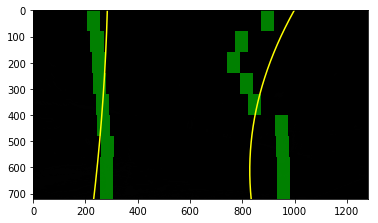

In [641]:
plt.imshow(output)

ploty = np.linspace(0, warped.shape[0]-1, warped.shape[0])
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)

plt.show()

# Measure curvature

In [760]:
def get_curvature(height, fit):
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension      
    
    ploty = np.linspace(0, height-1, num=height)
    y_eval = np.max(ploty)
    
    x_vals = fit[0]*ploty**2 + fit[1]*ploty + fit[2]    
    
    curverad = ((1 + (2*fit[0]*y_eval*ym_per_pix + fit[1])**2)**1.5) / np.absolute(2*fit[0])
    
    return curverad

In [761]:
def get_left_right_curvature(binary_warped, left_fit, right_fit):
    # Calculate the new radii of curvature
    left_curverad = get_curvature(binary_warped.shape[0], left_fit)
    right_curverad = get_curvature(binary_warped.shape[0], right_fit)
    
    return left_curverad, right_curverad

In [762]:
get_left_right_curvature(warped, left_fit, right_fit)

(4924.9299124737199, 3233.0236136320327)

# Draw lanes on road

In [803]:
def draw_lanes_and_annotations(image, warped, Minv, ploty, left_fitx, right_fitx,
                                  curverad, offset, lane_width, frame_id=0):
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0]))  
    
    # Combine the result with the original image
    #result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    output_img = cv2.addWeighted(image, 1, newwarp, 0.3, 0)

    frame_id_txt = 'Frame #%d' % frame_id
    curvature_txt = 'Curvature: %.2f' % curverad
    offset_txt = 'Offset: %.2f' % offset
    lane_width_txt = 'Lane Width: %.2f' % lane_width
    
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(output_img, frame_id_txt, (10,60), font, 2,(0,0,0),2,cv2.LINE_AA)
    cv2.putText(output_img, curvature_txt, (10,120), font, 2,(0,0,0),2,cv2.LINE_AA)
    cv2.putText(output_img, offset_txt, (10,180), font, 2,(0,0,0),2,cv2.LINE_AA)
    cv2.putText(output_img, lane_width_txt, (10,240), font, 2,(0,0,0),2,cv2.LINE_AA)

    return output_img

In [645]:
image = sample_video_imgs_arr[0]
warped, Minv = apply_img_pipeline(image, objpoints, imgpoints) 

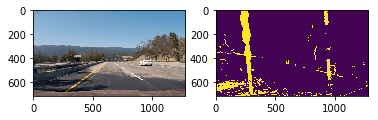

In [646]:
plt.subplot(1,2,1)
plt.imshow(image)
plt.subplot(1,2,2)
plt.imshow(warped)
plt.show()

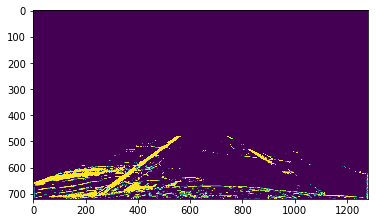

In [647]:
plt.imshow(cv2.warpPerspective(warped, Minv, (warped.shape[1], warped.shape[0])))

In [648]:
left_fit, right_fit, left_lane_inds, right_lane_inds, nonzeroy, nonzerox, out_img = fit_initial_lanes(warped)

In [649]:
left_fit, right_fit

(array([ -1.72265007e-05,   9.78741833e-02,   2.32053356e+02]),
 array([ -9.48564019e-05,   1.22618603e-01,   9.09064831e+02]))

In [650]:
def plot_to_points(warped_img, left_fit, right_fit):
    ploty = np.linspace(0, warped_img.shape[0]-1, warped_img.shape[0])
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return ploty, left_fitx, right_fitx 

In [651]:
ploty, left_fitx, right_fitx = plot_to_points(warped, left_fit, right_fit)

In [652]:
left_curverad, right_curverad = get_curvature(warped, left_fit, right_fit)
left_curverad, right_curverad

(9534.6068763699186, 1731.3273191601093)

In [653]:
curverad = (left_curverad + right_curverad)/2.0

In [654]:
offset = (image.shape[1]/2.0)-(left_fitx[-1]+right_fitx[-1])/2.0

In [655]:
road_with_lanes = draw_lanes_and_annotations(image, warped, Minv, ploty, left_fitx, right_fitx,
                                             curverad, offset)

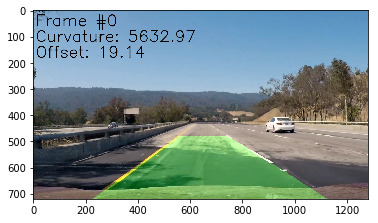

In [656]:
plt.imshow(road_with_lanes)
plt.show()

In [657]:
def process_road_imgs(img_files):
    road_with_lanes_arr = []

    for i, img_file in enumerate(tqdm(img_files)):
        img = imread(img_file)
        warped, Minv = apply_img_pipeline(img, objpoints, imgpoints) 
    
        if i == 0:
            left_fit, right_fit, _, _, _, _, _ = fit_initial_lanes(warped)
        else:
            left_fit, right_fit, _, _, _, _, _ = fit_lanes(warped, left_fit, right_fit)
        
        ploty, left_fitx, right_fitx = plot_to_points(warped, left_fit, right_fit)
    
        left_curverad, right_curverad = get_curvature(binary_warped, left_fit, right_fit)
        
        offset = (img.shape[1]/2.0)-(left_fitx[-1]+right_fitx[-1])/2.0
    
        road_with_lanes = draw_lanes_and_annotations(image, warped, Minv, ploty, left_fitx, right_fitx, 
                                                     left_curverad, right_curverad, offset, i)
        road_with_lanes_arr.append(road_with_lanes)    
        
    return road_with_lanes_arr

In [658]:
video_image_files = sorted(glob.glob('%s/*.jpg' % output_dir))[0:50]
road_with_lanes_arr = process_road_imgs(video_image_files)

  0%|          | 0/50 [00:00<?, ?it/s]


TypeError: draw_lanes_and_annotations() takes from 8 to 9 positional arguments but 10 were given

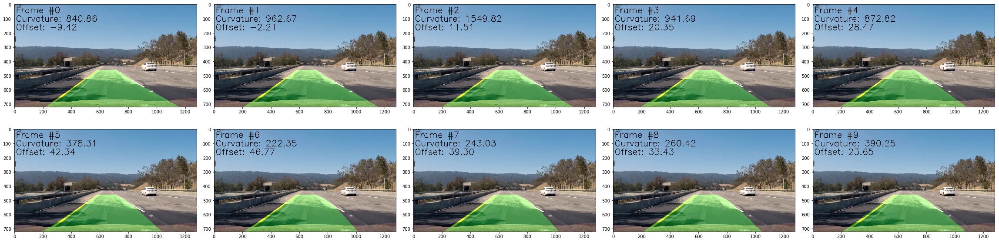

In [659]:
display_images(np.array(road_with_lanes_arr[0:10]), start_idx=0, columns=5, figsize=(32,12))

# Processing Video

## Define a class to receive the characteristics of each line detection

In [874]:
class Line(object):
    def __init__(self, img_height, max_n_fits):
        self.img_height = img_height
        self.max_n_fits = max_n_fits
        
        self.fits = []
        
        self._y_vals = None
        
        self._last_mean_fit = None
        
    @property
    def mean_fit(self):
        if self.fits is None or len(self.fits) == 0:
            return None
        
        # Yah! Side effects! Cache the mean_fit value in last_mean_fit so you don't have to recalc.
        self._last_mean_fit = np.mean(self.fits, axis=0)
        
        return self._last_mean_fit
    
    @property
    def last_mean_fit(self):
        if self._last_mean_fit is None:
            self._last_mean_fit = self.mean_fit
            
        return self._last_mean_fit
    
    @property
    def y_vals(self):
        if self._y_vals is None:
            self._y_vals = np.linspace(0, self.img_height-1, num=self.img_height)
            
        return self._y_vals
    
    @property
    def x_vals(self):
        if self.mean_fit is None:
            return None
        
        return self.mean_fit[0] * self.y_vals**2 + self.mean_fit[1] * self.y_vals + self.mean_fit[2]
    
    @property
    def bottom_x(self):
        if self.mean_fit is None:
            return None
        
        return self.mean_fit[0] * self.img_height**2 + self.mean_fit[1] * self.img_height + self.mean_fit[2]
          
    @property
    def radius_of_curvature(self):
        """
        radius of curvature of the line in meters
        """
        # Define conversions in x and y from pixels space to meters
        ym_per_pix = 30/720 # meters per pixel in y dimension
        xm_per_pix = 3.7/700 # meters per pixel in x dimension    

        fit = np.polyfit(self.y_vals*ym_per_pix, self.x_vals*xm_per_pix, 2)

        # Calculate the new radii of curvature
        radius_of_curvature = ((1 + (2*fit[0]*self.img_height*ym_per_pix + 
                                     fit[1])**2)**1.5) / np.absolute(2*fit[0])

        return radius_of_curvature 
    
    def add_fit(self, fit):
        self.fits.append(fit)
        
        if len(self.fits) > self.max_n_fits:
            self.fits = self.fits[-self.max_n_fits:]
            
    def clear_fits(self):
        self.fits = []
                
    def get_tangent(self, y):
        # Define conversions in x and y from pixels space to meters
        ym_per_pix = 30/720 # meters per pixel in y dimension
        xm_per_pix = 3.7/700 # meters per pixel in x dimension    

        fit = np.polyfit(self.y_vals*ym_per_pix, self.x_vals*xm_per_pix, 2)
        
        return (2*fit[0]*self.img_height*ym_per_pix + fit[1])
    
    def get_tangent_side(self, y):
        if self.get_tangent(y) < 0.0:
            return 'to the left'
        elif self.get_tangent(y)> 0.0:
            return 'to the right'
        else:
            return 'straight'

In [661]:
output_dir = '%s/project_video' % data_dir
video_image_files = sorted(glob.glob('%s/*.jpg' % output_dir))
len(video_image_files)

1259

In [850]:
def calc_lane_width(img_height, left_fit, right_fit):
    xm_per_pix = 3.7/700
    
    left_bottom_x = left_fit[0] * img_height**2 + left_fit[1] * img_height + left_fit[2]
    right_bottom_x = right_fit[0] * img_height**2 + right_fit[1] * img_height + right_fit[2]
    lane_width = (right_bottom_x - left_bottom_x) * xm_per_pix
    
    return lane_width

In [901]:
def center_adj_fits(img_height, img_width, left_fit, right_fit, lane_width=3.2, offset=0.0):
    left_bottom_x = left_fit[0] * img_height**2 + left_fit[1] * img_height + left_fit[2]
    right_bottom_x = right_fit[0] * img_height**2 + right_fit[1] * img_height + right_fit[2]
    center_bottom_x = (left_bottom_x+right_bottom_x)/2.0 - offset
    
    left_x_adj = (center_bottom_x-left_bottom_x) - (lane_width/2.0)
    right_x_adj = (right_bottom_x-center_bottom_x) - (lane_width/2.0)
    
    y_vals = np.linspace(0, img_height-1, num=img_height)
    
    left_x_adj_vals = left_fit[0] * y_vals**2 + left_fit[1] * y_vals + left_fit[2] + left_x_adj
    right_x_adj_vals = right_fit[0] * y_vals**2 + right_fit[1] * y_vals + right_fit[2] - right_x_adj
    
    # Fit a second order polynomial to each
    left_fit_adj = np.polyfit(y_vals, left_x_adj_vals, 2)
    right_fit_adj = np.polyfit(y_vals, right_x_adj_vals, 2)
                                          
    return left_fit_adj, right_fit_adj

In [ ]:
def get_basic_fits(img, min_y=None):
    if min_y is None:
        min_y = int((2.0/3.0)*img.shape[0])
        
    lane_mask = find_lane3(img)[:,:,0]
    
    

In [976]:
def make_lane_line_frames(img_files, output_dir, 
                          window_width = 50, window_height = 80, margin = 100, 
                          max_n_fits=10, start_idx=0, min_lane_width=None, max_lane_width=None):
    os.makedirs(output_dir, exist_ok=True)
    
    frame_files = []
    curvatures = []
    
    img_shape = imread(img_files[0]).shape
    img_height = img_shape[0]
    img_width = img_shape[1]
    
    left_line = Line(img_height, max_n_fits)
    right_line = Line(img_height, max_n_fits)
    ploty = left_line.y_vals

    init_fit_lanes = True
    xm_per_pix = 3.7/700
    offset = 0.0
    
    for i, img_file in enumerate(tqdm(img_files)):
        print("###", i)
        img = imread(img_file)
        print("###img min(), max()", img.min(), img.max())
        print("###img", img.shape, img.dtype)
        
        if init_fit_lanes:
            basic_lane_lines_img = get_basic_lane_lines(img)
            print("###basic_lane_lines_img min(), max()", basic_lane_lines_img.min(), basic_lane_lines_img.max())
            print("###basic_lane_lines_img", basic_lane_lines_img.shape, basic_lane_lines_img.dtype)
            warped, Minv = apply_img_pipeline(basic_lane_lines_img, objpoints, imgpoints) 
            left_fit, right_fit, _, _, _, _, _ = fit_initial_lanes(warped)
            init_fit_lanes = False
        else:
            warped, Minv = apply_img_pipeline(img, objpoints, imgpoints) 
            left_fit, right_fit, _, _, _, _, _ = fit_lanes(warped, left_line.last_mean_fit, 
                                                           right_line.last_mean_fit, margin = margin)
            
            if max_lane_width is not None:
                lane_width = calc_lane_width(img_height, left_fit, right_fit)
            
                if lane_width > max_lane_width:
                    # if the lane width is too wide, use centroid fit instead
                    print("###lane_width", lane_width)
                    centroid_left_fit, centroid_right_fit = get_window_centroid_fit(warped, window_width, 
                                                                                    window_height, margin)
                    centroid_lane_width = calc_lane_width(img_height, centroid_left_fit, centroid_right_fit)
                
                    if centroid_lane_width < lane_width:
                        # use the fits from the smaller lane width
                        print("using centroid fit")
                        left_fit, right_fit = centroid_left_fit, centroid_right_fit
                
        left_line.add_fit(left_fit)
        right_line.add_fit(right_fit)

        frame_idx = i+start_idx

        offset = (img.shape[1]/2.0)-(left_line.bottom_x+right_line.bottom_x)/2.0
        
        lane_width = (right_line.bottom_x - left_line.bottom_x) * xm_per_pix
        print("###lane_width", lane_width)
        if ((min_lane_width is not None and lane_width < min_lane_width) or 
            (max_lane_width is not None and lane_width > max_lane_width))  :
            # if the lane width is still too narrow or too wide, go back to find init lanes
            print(i, lane_width, "resetting find lanes")
            # the width of the lane seems too wide. reinit finding the lanes
            init_fit_lanes = True
        
        curverad = np.min([left_line.radius_of_curvature, right_line.radius_of_curvature])
        curvatures.append(curverad)
            
        road_with_lanes = draw_lanes_and_annotations(img, warped, Minv, ploty, 
                                                     left_line.x_vals, right_line.x_vals, 
                                                     curverad, offset, lane_width, frame_idx)

        """
        plt.imshow(road_with_lanes)
        plt.show()
        """
        
        frame_file = "%s/frame_%s.jpg" % (output_dir, pad_zeros(frame_idx))
        imsave(frame_file, road_with_lanes)
        
        frame_files.append(frame_file)

    return frame_files, curvatures

In [977]:
lane_line_dir = '%s/lane_lines' % data_dir

In [978]:
video_image_files = sorted(glob.glob('%s/*.jpg' % output_dir))

frame_files, curvatures = make_lane_line_frames(video_image_files[:20], lane_line_dir, max_n_fits=10, start_idx=0)

  0%|          | 0/20 [00:00<?, ?it/s]

### 0
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  5%|▌         | 1/20 [00:04<01:26,  4.54s/it]

###lane_width 3.11927508359
### 1
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 10%|█         | 2/20 [00:06<01:07,  3.77s/it]

###fit_lane - leftx 13670
###fit_lane - left_min_y, left_max_y 67 719
###fit_lane - rightx 13307
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.09916774154
### 2
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 15%|█▌        | 3/20 [00:08<00:54,  3.21s/it]

###fit_lane - leftx 13479
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 13181
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.08877136535
### 3
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 20%|██        | 4/20 [00:11<00:49,  3.08s/it]

###fit_lane - leftx 13713
###fit_lane - left_min_y, left_max_y 18 719
###fit_lane - rightx 12825
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.07776765706
### 4
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 25%|██▌       | 5/20 [00:14<00:46,  3.13s/it]

###fit_lane - leftx 13693
###fit_lane - left_min_y, left_max_y 12 719
###fit_lane - rightx 12253
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.06811598184
### 5
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 30%|███       | 6/20 [00:16<00:41,  2.96s/it]

###fit_lane - leftx 13104
###fit_lane - left_min_y, left_max_y 43 719
###fit_lane - rightx 12488
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.06432883086
### 6
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 35%|███▌      | 7/20 [00:19<00:36,  2.83s/it]

###fit_lane - leftx 13042
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 12544
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.06744092072
### 7
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 40%|████      | 8/20 [00:22<00:35,  2.96s/it]

###fit_lane - leftx 12677
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 12611
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.07167031816
### 8
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 12890
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 12677
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.07207804693


 45%|████▌     | 9/20 [00:24<00:29,  2.64s/it]

### 9
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 50%|█████     | 10/20 [00:27<00:25,  2.58s/it]

###fit_lane - leftx 13226
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 12668
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.0745384101
### 10
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 12150
###fit_lane - left_min_y, left_max_y 44 719
###fit_lane - rightx 11802
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.07328647228


 55%|█████▌    | 11/20 [00:29<00:23,  2.62s/it]

### 11
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 60%|██████    | 12/20 [00:32<00:21,  2.72s/it]

###fit_lane - leftx 12561
###fit_lane - left_min_y, left_max_y 28 718
###fit_lane - rightx 12883
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.07439457531
### 12
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 12732
###fit_lane - left_min_y, left_max_y 28 719
###fit_lane - rightx 13492
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.07845598214


 65%|██████▌   | 13/20 [00:35<00:18,  2.58s/it]

### 13
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 70%|███████   | 14/20 [00:37<00:14,  2.47s/it]

###fit_lane - leftx 12457
###fit_lane - left_min_y, left_max_y 54 719
###fit_lane - rightx 13522
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.08542206818
### 14
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###fit_lane - leftx 12556
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 13550
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.09382705136


 75%|███████▌  | 15/20 [00:39<00:12,  2.40s/it]

### 15
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 80%|████████  | 16/20 [00:41<00:09,  2.32s/it]

###fit_lane - leftx 12914
###fit_lane - left_min_y, left_max_y 29 719
###fit_lane - rightx 14064
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.10096904665
### 16
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 85%|████████▌ | 17/20 [00:43<00:06,  2.12s/it]

###fit_lane - leftx 12360
###fit_lane - left_min_y, left_max_y 75 718
###fit_lane - rightx 13340
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.10481818897
### 17
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 90%|█████████ | 18/20 [00:44<00:03,  1.99s/it]

###fit_lane - leftx 12065
###fit_lane - left_min_y, left_max_y 55 719
###fit_lane - rightx 13131
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.10811677936
### 18
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 95%|█████████▌| 19/20 [00:46<00:01,  1.87s/it]

###fit_lane - leftx 12613
###fit_lane - left_min_y, left_max_y 68 719
###fit_lane - rightx 13148
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 3.11398935601
### 19
###img min(), max() 0 255
###img (720, 1280, 3) uint8


100%|██████████| 20/20 [00:48<00:00,  1.79s/it]

###fit_lane - leftx 11984
###fit_lane - left_min_y, left_max_y 55 719
###fit_lane - rightx 12037
###fit_lane - right_min_y, right_max_y 4 719
###lane_width 3.11567252946


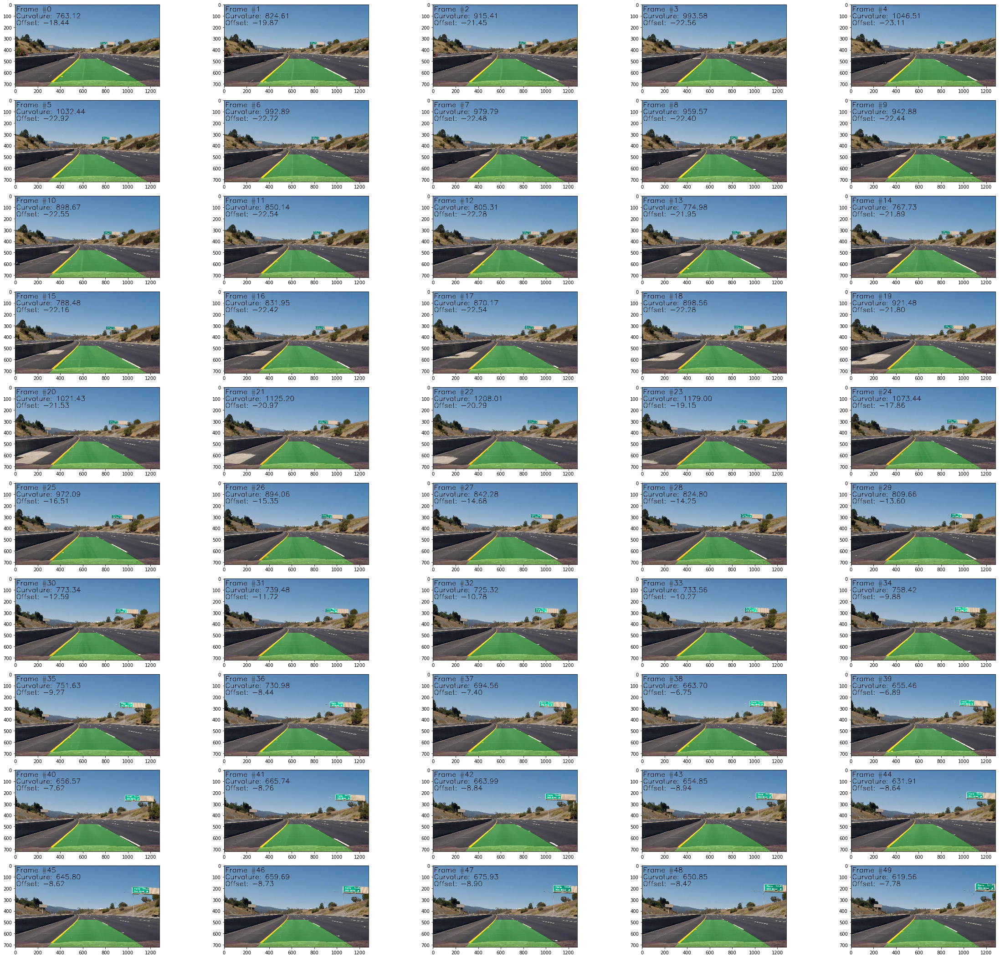

In [790]:
lane_line_image_files = sorted(glob.glob('%s/*.jpg' % lane_line_dir))
lane_line_images = read_imgs(lane_line_image_files)
figsize=(32,32)
display_images(lane_line_images, start_idx=0, end_idx=50, columns=5, figsize=figsize)

## Challenge Video

In [949]:
video = 'challenge_video.mp4'
output_dir = '%s/challenge_video' % data_dir
extract_video_imgs(video, output_dir)

100%|██████████| 484/484 [00:58<00:00,  8.30it/s]

In [979]:
video_image_files = sorted(glob.glob('%s/*.jpg' % output_dir))
len(video_image_files)

483

In [982]:
lane_line_dir = '%s/lane_lines_challenge_video' % data_dir

In [ ]:
video_image_files = sorted(glob.glob('%s/*.jpg' % output_dir))

frame_files, curvatures = make_lane_line_frames(video_image_files, lane_line_dir, 
                                                max_n_fits=10, start_idx=0, margin=50,
                                                min_lane_width=None, max_lane_width=3.0)

  0%|          | 0/483 [00:00<?, ?it/s]

### 0
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  0%|          | 1/483 [00:03<31:28,  3.92s/it]

###lane_width 3.11927508359
0 3.11927508359 resetting find lanes
### 1
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  0%|          | 2/483 [00:07<30:25,  3.80s/it]

###lane_width 3.12521036385
1 3.12521036385 resetting find lanes
### 2
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  1%|          | 3/483 [00:10<29:30,  3.69s/it]

###lane_width 3.11725997992
2 3.11725997992 resetting find lanes
### 3
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  1%|          | 4/483 [00:14<29:06,  3.65s/it]

###lane_width 3.11159856616
3 3.11159856616 resetting find lanes
### 4
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  1%|          | 5/483 [00:18<29:07,  3.66s/it]

###lane_width 3.11365631137
4 3.11365631137 resetting find lanes
### 5
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  1%|          | 6/483 [00:21<27:18,  3.43s/it]

###lane_width 3.10984867271
5 3.10984867271 resetting find lanes
### 6
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  1%|▏         | 7/483 [00:24<26:19,  3.32s/it]

###lane_width 3.10741572693
6 3.10741572693 resetting find lanes
### 7
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  2%|▏         | 8/483 [00:27<26:50,  3.39s/it]

###lane_width 3.11074517729
7 3.11074517729 resetting find lanes
### 8
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  2%|▏         | 9/483 [00:30<25:42,  3.25s/it]

###lane_width 3.11330472207
8 3.11330472207 resetting find lanes
### 9
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  2%|▏         | 10/483 [00:33<24:32,  3.11s/it]

###lane_width 3.11825515026
9 3.11825515026 resetting find lanes
### 10
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  2%|▏         | 11/483 [00:36<23:28,  2.98s/it]

###lane_width 3.11817831794
10 3.11817831794 resetting find lanes
### 11
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  2%|▏         | 12/483 [00:38<22:45,  2.90s/it]

###lane_width 3.11296654963
11 3.11296654963 resetting find lanes
### 12
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8
###lane_width 3.11461741832
12 3.11461741832 resetting find lanes


  3%|▎         | 13/483 [00:44<28:38,  3.66s/it]

### 13
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  3%|▎         | 14/483 [00:48<29:59,  3.84s/it]

###lane_width 3.11628562374
13 3.11628562374 resetting find lanes
### 14
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  3%|▎         | 15/483 [00:51<28:30,  3.65s/it]

###lane_width 3.1183435072
14 3.1183435072 resetting find lanes
### 15
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  3%|▎         | 16/483 [00:54<27:16,  3.50s/it]

###lane_width 3.12050027717
15 3.12050027717 resetting find lanes
### 16
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  4%|▎         | 17/483 [00:58<26:54,  3.46s/it]

###lane_width 3.1222272453
16 3.1222272453 resetting find lanes
### 17
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  4%|▎         | 18/483 [01:01<25:31,  3.29s/it]

###lane_width 3.11388106184
17 3.11388106184 resetting find lanes
### 18
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  4%|▍         | 19/483 [01:03<24:25,  3.16s/it]

###lane_width 3.10770149998
18 3.10770149998 resetting find lanes
### 19
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  4%|▍         | 20/483 [01:07<26:01,  3.37s/it]

###lane_width 3.10005266511
19 3.10005266511 resetting find lanes
### 20
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  4%|▍         | 21/483 [01:11<25:42,  3.34s/it]

###lane_width 3.09814048296
20 3.09814048296 resetting find lanes
### 21
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  5%|▍         | 22/483 [01:13<24:40,  3.21s/it]

###lane_width 3.09615266889
21 3.09615266889 resetting find lanes
### 22
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  5%|▍         | 23/483 [01:17<25:24,  3.31s/it]

###lane_width 3.09003662798
22 3.09003662798 resetting find lanes
### 23
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  5%|▍         | 24/483 [01:20<25:07,  3.28s/it]

###lane_width 3.08765004614
23 3.08765004614 resetting find lanes
### 24
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  5%|▌         | 25/483 [01:23<24:31,  3.21s/it]

###lane_width 3.0789812449
24 3.0789812449 resetting find lanes
### 25
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  5%|▌         | 26/483 [01:27<25:08,  3.30s/it]

###lane_width 3.07807268366
25 3.07807268366 resetting find lanes
### 26
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  6%|▌         | 27/483 [01:31<26:20,  3.47s/it]

###lane_width 3.06740989266
26 3.06740989266 resetting find lanes
### 27
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  6%|▌         | 28/483 [01:35<27:22,  3.61s/it]

###lane_width 3.05956058265
27 3.05956058265 resetting find lanes
### 28
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  6%|▌         | 29/483 [01:38<27:07,  3.58s/it]

###lane_width 3.05240900006
28 3.05240900006 resetting find lanes
### 29
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  6%|▌         | 30/483 [01:41<26:00,  3.44s/it]

###lane_width 3.05107164188
29 3.05107164188 resetting find lanes
### 30
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  6%|▋         | 31/483 [01:45<25:48,  3.43s/it]

###lane_width 3.03750485682
30 3.03750485682 resetting find lanes
### 31
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  7%|▋         | 32/483 [01:48<25:59,  3.46s/it]

###lane_width 3.03251111674
31 3.03251111674 resetting find lanes
### 32
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  7%|▋         | 33/483 [01:52<25:59,  3.46s/it]

###lane_width 3.02710854142
32 3.02710854142 resetting find lanes
### 33
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  7%|▋         | 34/483 [01:55<24:54,  3.33s/it]

###lane_width 3.02231877822
33 3.02231877822 resetting find lanes
### 34
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  7%|▋         | 35/483 [01:58<25:16,  3.38s/it]

###lane_width 3.01828740658
34 3.01828740658 resetting find lanes
### 35
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  7%|▋         | 36/483 [02:01<24:24,  3.28s/it]

###lane_width 3.03341576873
35 3.03341576873 resetting find lanes
### 36
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  8%|▊         | 37/483 [02:05<25:01,  3.37s/it]

###lane_width 3.0565550079
36 3.0565550079 resetting find lanes
### 37
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  8%|▊         | 38/483 [02:08<25:45,  3.47s/it]

###lane_width 3.07269855141
37 3.07269855141 resetting find lanes
### 38
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  8%|▊         | 39/483 [02:12<24:51,  3.36s/it]

###lane_width 3.09306667317
38 3.09306667317 resetting find lanes
### 39
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  8%|▊         | 40/483 [02:15<25:51,  3.50s/it]

###lane_width 3.0928781588
39 3.0928781588 resetting find lanes
### 40
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  8%|▊         | 41/483 [02:19<25:46,  3.50s/it]

###lane_width 3.10053689481
40 3.10053689481 resetting find lanes
### 41
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  9%|▊         | 42/483 [02:22<24:37,  3.35s/it]

###lane_width 3.09505072646
41 3.09505072646 resetting find lanes
### 42
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  9%|▉         | 43/483 [02:25<23:25,  3.20s/it]

###lane_width 3.09472068481
42 3.09472068481 resetting find lanes
### 43
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  9%|▉         | 44/483 [02:27<22:28,  3.07s/it]

###lane_width 3.06348459
43 3.06348459 resetting find lanes
### 44
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


  9%|▉         | 45/483 [02:30<21:54,  3.00s/it]

###lane_width 3.03469127033
44 3.03469127033 resetting find lanes
### 45
###img min(), max() 0 255
###img (720, 1280, 3) uint8
###basic_lane_lines_img min(), max() 0 204
###basic_lane_lines_img (720, 1280, 3) uint8


 10%|▉         | 46/483 [02:33<21:22,  2.94s/it]

###lane_width 2.99631809284
### 46
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 10%|▉         | 47/483 [02:35<18:34,  2.56s/it]

###fit_lane - leftx 1578
###fit_lane - left_min_y, left_max_y 477 719
###fit_lane - rightx 1643
###fit_lane - right_min_y, right_max_y 0 719
###lane_width 2.9674316297
### 47
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 10%|▉         | 48/483 [02:36<16:22,  2.26s/it]

###fit_lane - leftx 1840
###fit_lane - left_min_y, left_max_y 488 719
###fit_lane - rightx 2193
###fit_lane - right_min_y, right_max_y 33 719
###lane_width 3.0350447264
###lane_width 2.95758291931
### 48
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 10%|█         | 49/483 [02:38<15:03,  2.08s/it]

###fit_lane - leftx 2536
###fit_lane - left_min_y, left_max_y 0 719
###fit_lane - rightx 2477
###fit_lane - right_min_y, right_max_y 59 718
###lane_width 3.0992003572
###lane_width 2.94708786969
### 49
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 10%|█         | 50/483 [02:40<13:51,  1.92s/it]

###fit_lane - leftx 3143
###fit_lane - left_min_y, left_max_y 106 719
###fit_lane - rightx 3468
###fit_lane - right_min_y, right_max_y 75 718
###lane_width 3.08238225191
###lane_width 2.94821990191
### 50
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 11%|█         | 51/483 [02:41<12:59,  1.80s/it]

###fit_lane - leftx 3774
###fit_lane - left_min_y, left_max_y 79 719
###fit_lane - rightx 3213
###fit_lane - right_min_y, right_max_y 98 719
###lane_width 3.14158107894
###lane_width 2.95834756496
### 51
###img min(), max() 0 255
###img (720, 1280, 3) uint8


 11%|█         | 52/483 [02:43<13:12,  1.84s/it]

###fit_lane - leftx 4818
###fit_lane - left_min_y, left_max_y 108 719
###fit_lane - rightx 3223
###fit_lane - right_min_y, right_max_y 94 719
###lane_width 3.14003607577
###lane_width 2.97691609895
### 52
###img min(), max() 0 255
###img (720, 1280, 3) uint8


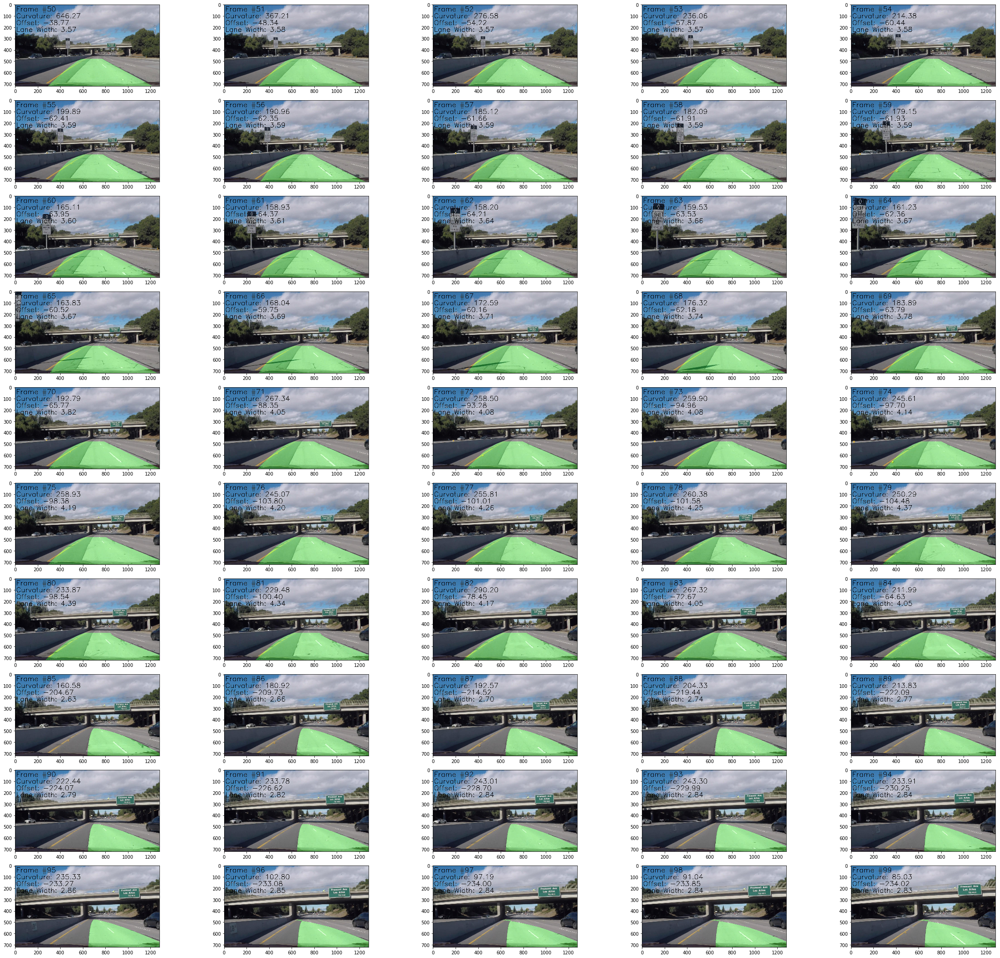

In [816]:
lane_line_image_files = sorted(glob.glob('%s/*.jpg' % lane_line_dir))
lane_line_images = read_imgs(lane_line_image_files)
figsize=(32,32)
display_images(lane_line_images, start_idx=0, end_idx=50, columns=5, figsize=figsize)

In [921]:
lane_line_imgs = []

for i, video_image_file in enumerate(tqdm(video_image_files[:50])):
    img = imread(video_image_file)
    undistorted_img = cal_undistort(img, objpoints, imgpoints)
    lane_line_img = weighted_img(find_lane3(undistorted_img), undistorted_img)
    lane_line_imgs.append(lane_line_img)

100%|██████████| 50/50 [01:10<00:00,  1.32s/it]


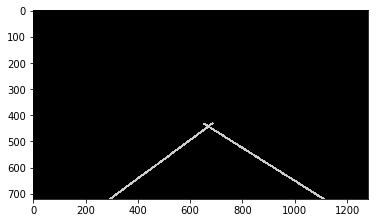

In [946]:
img = imread(video_image_files[0])
undistorted_img = cal_undistort(img, objpoints, imgpoints)
foo = find_lane3(undistorted_img)
foo[:,:,1] = foo[:,:,0]
foo[:,:,2] = foo[:,:,0]
plt.imshow(foo)

In [940]:
def get_hough_lines(image):
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)

    # Define a kernel size and apply Gaussian smoothing                                                                                    
    kernel_size = 5
    blur_gray = gaussian_blur(gray, kernel_size)

    # Define our parameters for Canny and apply                                                                                            
    low_threshold = 50
    high_threshold = 150
    edges = canny(blur_gray, low_threshold, high_threshold)

    masked_edges = crop_roi(edges)

    # Define the Hough transform parameters                                                                                                
    # Make a blank the same size as our image to draw on                                                                                   
    rho = 1 # distance resolution in pixels of the Hough grid                                                                              
    theta = np.pi/180 # angular resolution in radians of the Hough grid                                                                    
    threshold = 64    # minimum number of votes (intersections in Hough grid cell)                                                         

    min_line_length = 5 #minimum number of pixels making up a line                                                                         
    max_line_gap = 100    # maximum gap in pixels between connectable line segments                                                        
    line_image = np.copy(image)*0 # creating a blank to draw lines on   

    return cv2.HoughLinesP(masked_edges, rho, theta, threshold, np.array([]), minLineLength=min_line_length, 
                           maxLineGap=max_line_gap)

In [941]:
img.min(), img.max()

(0, 255)

In [944]:
get_hough_lines(img)

array([[[ 323,  694,  681,  434]],

       [[ 657,  432, 1080,  696]],

       [[ 778,  511, 1106,  693]],

       [[ 316,  715,  678,  432]],

       [[ 895,  592, 1070,  697]],

       [[ 399,  706,  512,  708]],

       [[ 321,  694,  539,  536]],

       [[ 315,  715,  673,  435]],

       [[ 530,  709,  693,  717]],

       [[ 660,  432, 1079,  694]],

       [[ 454,  609,  681,  432]],

       [[ 462,  505,  705,  439]],

       [[ 656,  432, 1051,  679]],

       [[ 165,  701,  345,  710]],

       [[ 682,  436,  915,  605]],

       [[ 702,  450,  917,  606]],

       [[ 648,  438, 1108,  693]],

       [[ 472,  585,  706,  433]],

       [[ 491,  708,  688,  718]],

       [[ 605,  467,  708,  449]],

       [[ 662,  432,  779,  505]]], dtype=int32)

In [928]:
foo[:,:,1].min(), foo[:,:,1].max()

(0, 0)

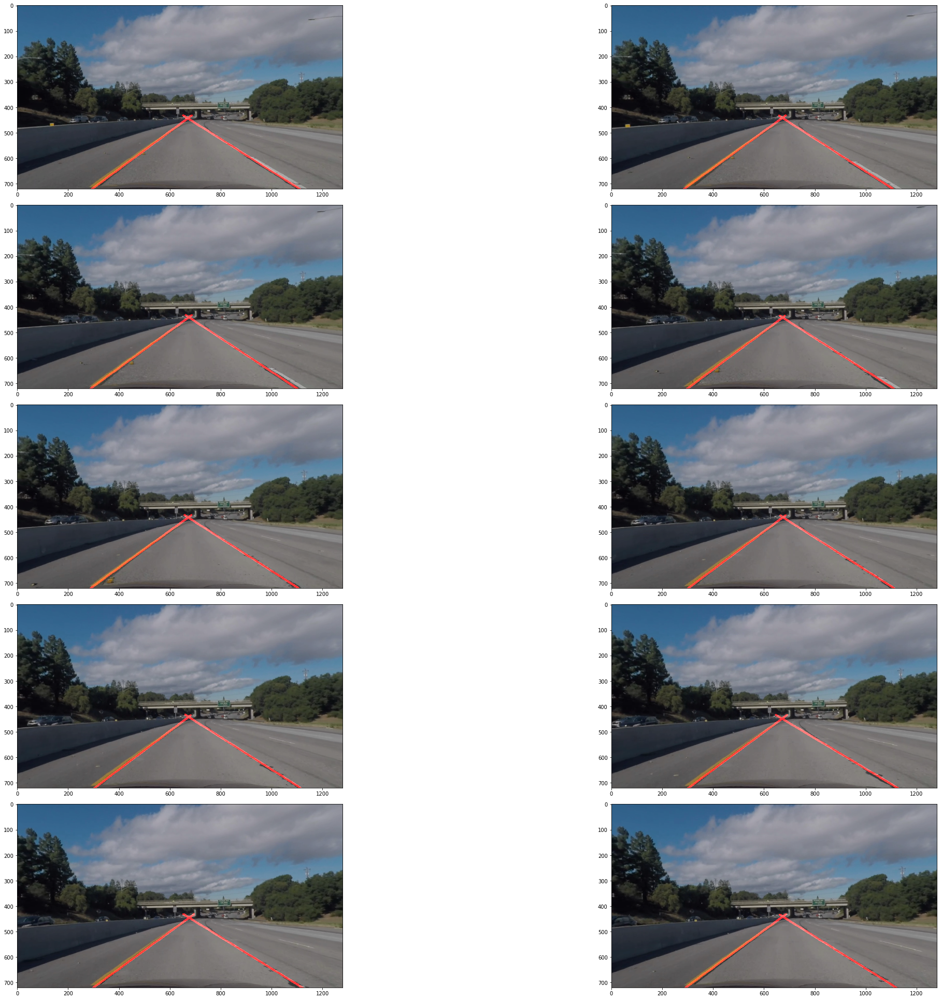

In [923]:
figsize=(32,32)
display_images(lane_line_imgs, start_idx=0, end_idx=10, columns=2, figsize=figsize)